## Tourism Gentrification: The Case of San Juan, Puerto Rico

In this project, I explore the interactions between the processes of gentrification and tourism in San Juan, Puerto Rico, with an emphasis on Santurce. I will use three datasets: two from the American Community Census (ACS) 5-year 2019 estimates and one from geodata collected by the government of Puerto Rico. From the ACS, I use the race variable and the mean household income for block groups in San Juan. I also use data from the government to map hotels and tourist inns in San Juan, Puerto Rico. 

### Gentrification Indicators

#### Mean Income

Importing my data, pandas,geopandas, contextily for basemaps, and matplotlib and plotly for graphics.

In [1]:
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import plotly.express as px

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
#importing data
income=gpd.read_file('acs2019_san juan_household_income.geojson')

Now, I will conduct some data exploration/cleaning.

In [3]:
income.shape

(365, 37)

In [4]:
income

,geoid,name,B19001001,"B19001001, Error",B19001002,"B19001002, Error",B19001003,"B19001003, Error",B19001004,"B19001004, Error",...,"B19001013, Error",B19001014,"B19001014, Error",B19001015,"B19001015, Error",B19001016,"B19001016, Error",B19001017,"B19001017, Error",geometry
0,15000US721270004001,"Block Group 1, San Juan, PR",384.0,83.0,191.0,67.0,54.0,45.0,36.0,34.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.11862 18.46914, -66.11834 ..."
1,15000US721270004002,"Block Group 2, San Juan, PR",311.0,71.0,69.0,32.0,44.0,36.0,14.0,15.0,...,11.0,7.0,11.0,26.0,30.0,18.0,22.0,14.0,22.0,"MULTIPOLYGON (((-66.11601 18.46817, -66.11569 ..."
2,15000US721270005061,"Block Group 1, San Juan, PR",362.0,86.0,66.0,38.0,11.0,15.0,54.0,36.0,...,18.0,0.0,14.0,0.0,14.0,10.0,15.0,21.0,23.0,"MULTIPOLYGON (((-66.11925 18.46353, -66.11908 ..."
3,15000US721270005062,"Block Group 2, San Juan, PR",481.0,104.0,45.0,40.0,69.0,55.0,31.0,35.0,...,31.0,55.0,42.0,0.0,14.0,13.0,14.0,39.0,28.0,"MULTIPOLYGON (((-66.12455 18.46155, -66.12021 ..."
4,15000US721270006001,"Block Group 1, San Juan, PR",265.0,64.0,152.0,61.0,44.0,36.0,10.0,17.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.10417 18.46589, -66.10386 ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,15000US721279801071,"Block Group 1, San Juan, PR",0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.11387 18.47213, -66.11294 ..."
361,15000US721279801081,"Block Group 1, San Juan, PR",0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.10669 18.45646, -66.10667 ..."
362,15000US721279802001,"Block Group 1, San Juan, PR",34.0,28.0,17.0,20.0,17.0,19.0,0.0,14.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.12927 18.47174, -66.12912 ..."
363,15000US721279803001,"Block Group 1, San Juan, PR",0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.08527 18.44116, -66.08280 ..."


In [5]:
#dropping the 0 column
income = income.drop([0])

In [6]:
#Now I will drop the columns that are marked as error
columns_to_keep = ['geoid',
 'name',
 'B19001001',
 'B19001002',
 'B19001003',
 'B19001004',
 'B19001005',
 'B19001006',
 'B19001007',
 'B19001008',
 'B19001009',
 'B19001010',
 'B19001011',
 'B19001012',
 'B19001013',
 'B19001014',
 'B19001015',
 'B19001016',
 'B19001017',
 'geometry']

In [7]:
# redefine variable with only columns to keep
income = income[columns_to_keep]

In [8]:
#renaming columns with their names (taken from the dictionary that came with the data)
income.columns = ['geoid',
 'name',
'Total',
'Less than $10,000',
'$10,000 to $14,999',
'$15,000 to $19,999',
'$20,000 to $24,999',
'$25,000 to $29,999',
'$30,000 to $34,999',
'$35,000 to $39,999',
'$40,000 to $44,999',
'$45,000 to $49,999',
'$50,000 to $59,999',
'$60,000 to $74,999',
'$75,000 to $99,999',
'$100,000 to $124,999',
'$125,000 to $149,999',
'$150,000 to $199,999',
'$200,000 or more',
 'geometry']

In [9]:
income_sorted = income.sort_values(by='Total',ascending = False)

In [10]:
income_sorted[['geoid','Total']].head(10)

,geoid,Total
364,16000US7276770,138385.0
199,15000US721270068001,2334.0
345,15000US721270100421,1100.0
316,15000US721270098005,1062.0
340,15000US721270100222,1023.0
334,15000US721270100022,1001.0
331,15000US721270100013,998.0
281,15000US721270091112,930.0
234,15000US721270080011,925.0
239,15000US721270080023,909.0


In [11]:
#Here, I am dropping that 364 row since it contains all of my data and it will skew my charts.
income = income.drop([364])

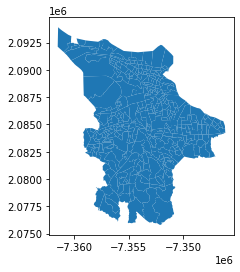

In [131]:
income_web_mercator.plot()
# add a basemap
ctx.add_basemap(ax)

In [13]:
#I am going to create some new columns that go with guidelines for poverty and normalize them (create percentages
income['Percent Households with Less than $19,999']=income['Less than $10,000']+ income['$15,000 to $19,999']/income['Total']*100
income['Households with Less than $19,999']=income['Less than $10,000']+ income['$15,000 to $19,999']
income['Percent Households with $20,000 to $49,999']=income['$20,000 to $24,999']+ income['$25,000 to $29,999']+ income['$30,000 to $34,999']+ income['$35,000 to $39,999']+ income['$40,000 to $44,999']+ income['$45,000 to $49,999']/income['Total']*100
income['Households with $20,000 to $49,999']=income['$20,000 to $24,999']+ income['$25,000 to $29,999']+ income['$30,000 to $34,999']+ income['$35,000 to $39,999']+ income['$40,000 to $44,999']+ income['$45,000 to $49,999']
income['Percent Households with $50,000 to $149,999']=income['$50,000 to $59,999']+income['$60,000 to $74,999']+income['$75,000 to $99,999']+income['$100,000 to $124,999']+ income['$125,000 to $149,999']/income['Total']*100
income['Households with $50,000 to $149,999']=income['$50,000 to $59,999']+income['$60,000 to $74,999']+income['$75,000 to $99,999']+income['$100,000 to $124,999']+ income['$125,000 to $149,999']
income['Percent Households with More than $125,000']= income['$125,000 to $149,999']+income['$150,000 to $199,999']+income['$200,000 or more']/income['Total']*100
income['Households with More than $125,000']= income['$125,000 to $149,999']+income['$150,000 to $199,999']+income['$200,000 or more']

In [14]:
income.head()

,geoid,name,Total,"Less than $10,000","$10,000 to $14,999","$15,000 to $19,999","$20,000 to $24,999","$25,000 to $29,999","$30,000 to $34,999","$35,000 to $39,999",...,"$200,000 or more",geometry,"Percent Households with Less than $19,999","Households with Less than $19,999","Percent Households with $20,000 to $49,999","Households with $20,000 to $49,999","Percent Households with $50,000 to $149,999","Households with $50,000 to $149,999","Percent Households with More than $125,000","Households with More than $125,000"
1,15000US721270004002,"Block Group 2, San Juan, PR",311.0,69.0,44.0,14.0,6.0,0.0,21.0,12.0,...,14.0,"MULTIPOLYGON (((-66.11601 18.46817, -66.11569 ...",73.501608,83.0,85.572347,91.0,43.360129,61.0,48.501608,58.0
2,15000US721270005061,"Block Group 1, San Juan, PR",362.0,66.0,11.0,54.0,22.0,52.0,0.0,0.0,...,21.0,"MULTIPOLYGON (((-66.11925 18.46353, -66.11908 ...",80.917127,120.0,130.077348,146.0,54.000000,54.0,15.801105,31.0
3,15000US721270005062,"Block Group 2, San Juan, PR",481.0,45.0,69.0,31.0,30.0,0.0,29.0,29.0,...,39.0,"MULTIPOLYGON (((-66.12455 18.46155, -66.12021 ...",51.444906,76.0,125.573805,143.0,141.000000,141.0,21.108108,52.0
4,15000US721270006001,"Block Group 1, San Juan, PR",265.0,152.0,44.0,10.0,18.0,6.0,0.0,6.0,...,0.0,"MULTIPOLYGON (((-66.10417 18.46589, -66.10386 ...",155.773585,162.0,30.000000,30.0,29.000000,29.0,0.000000,0.0
5,15000US721270006002,"Block Group 2, San Juan, PR",262.0,37.0,6.0,17.0,0.0,0.0,0.0,6.0,...,28.0,"MULTIPOLYGON (((-66.12381 18.46080, -66.12087 ...",43.488550,54.0,23.290076,27.0,100.870229,112.0,63.687023,81.0


I will now run some descriptive statistics, and then some histograms.

In [143]:
income['Total'].head()

1    311.0
2    362.0
3    481.0
4    265.0
5    262.0
Name: Total, dtype: float64

In [144]:
income['Total'].mean()

383.12396694214874

<AxesSubplot:ylabel='Frequency'>

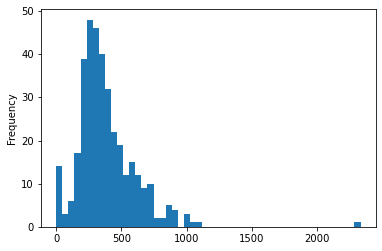

In [145]:
income['Total'].plot.hist(bins=50)

In [146]:
income['Total'].describe()

count     363.000000
mean      383.123967
std       226.645313
min         0.000000
25%       244.500000
50%       339.000000
75%       486.000000
max      2334.000000
Name: Total, dtype: float64

NameError: name 'StrMethodFormatter' is not defined

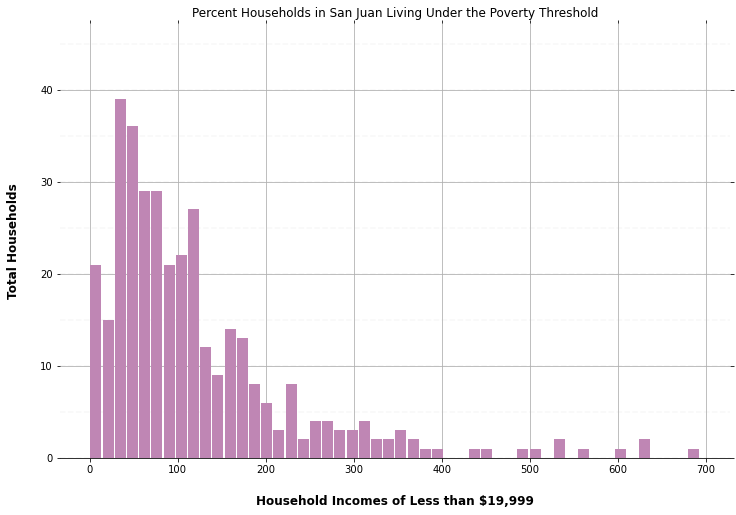

In [15]:
#I will be running now some histograms. 

ax = income.hist(column='Percent Households with Less than $19,999', bins=50, grid=True, figsize=(12,8), color='#bf86b4', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Percent Households in San Juan Living Under the Poverty Threshold")

    # Set x-axis label
    x.set_xlabel("Household Incomes of Less than $19,999", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("Total Households", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

NameError: name 'StrMethodFormatter' is not defined

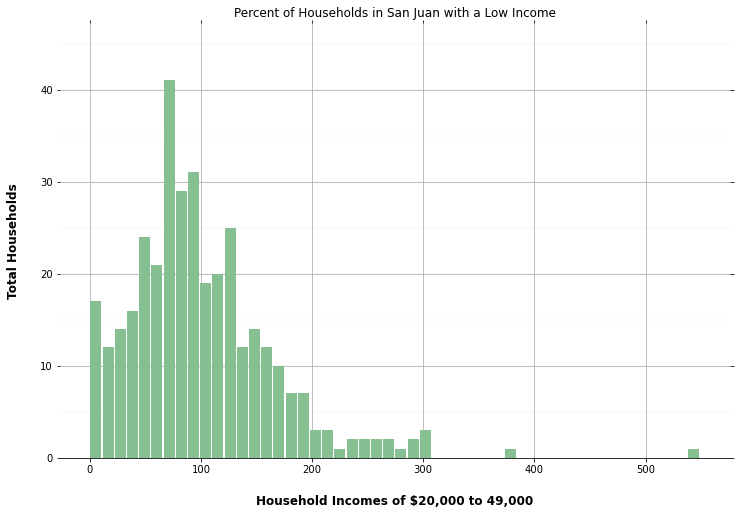

In [16]:
ax = income.hist(column='Percent Households with $20,000 to $49,999', bins=50, grid=True, figsize=(12,8), color='#86bf91', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Percent of Households in San Juan with a Low Income")

    # Set x-axis label
    x.set_xlabel("Household Incomes of $20,000 to 49,000", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("Total Households", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

NameError: name 'StrMethodFormatter' is not defined

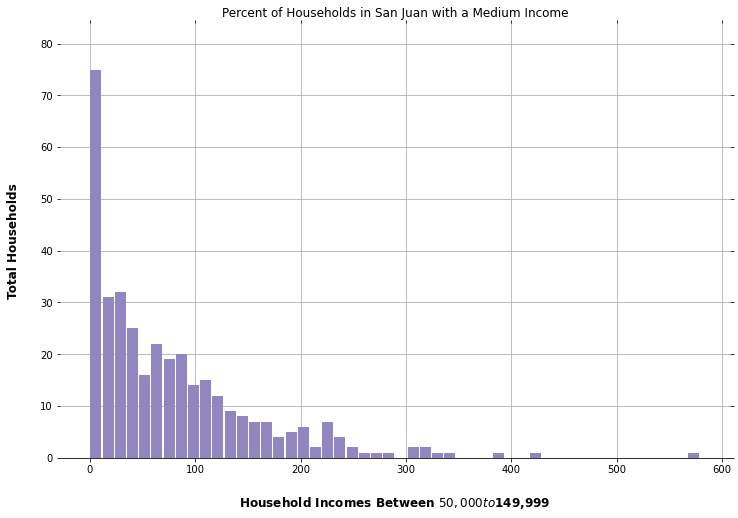

In [17]:
ax = income.hist(column='Percent Households with $50,000 to $149,999', bins=50, grid=True, figsize=(12,8), color='#9186bf', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Percent of Households in San Juan with a Medium Income")

    # Set x-axis label
    x.set_xlabel("Household Incomes Between $50,000 to $149,999", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("Total Households", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

NameError: name 'StrMethodFormatter' is not defined

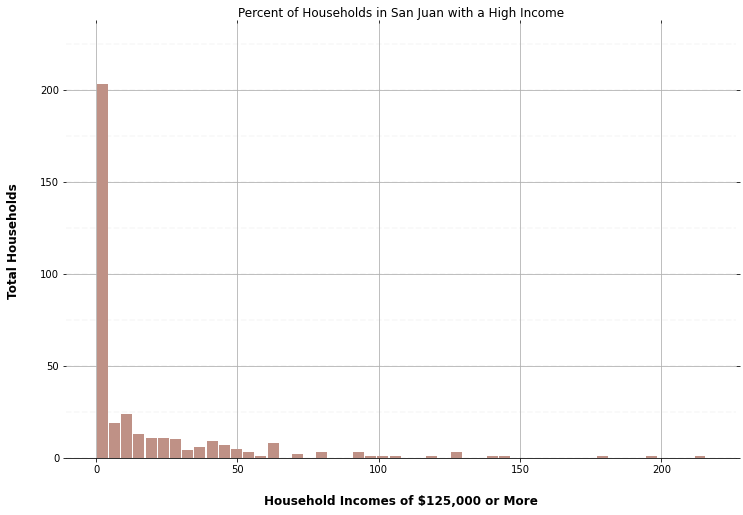

In [18]:
ax = income.hist(column='Percent Households with More than $125,000', bins=50, grid=True, figsize=(12,8), color='#bf9186', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Percent of Households in San Juan with a High Income")

    # Set x-axis label
    x.set_xlabel("Household Incomes of $125,000 or More", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("Total Households", labelpad=20, weight='bold', size=12)

    # Format y-axis label
    x.yaxis.set_major_formatter(StrMethodFormatter('{x:,g}'))

These histograms let me see the distribution of the data.

Now, I will be creating some maps to better visualize this. 

In [19]:
# reproject to Web Mercator
income_web_mercator = income.to_crs(epsg=3857)

Text(0.5, 1.0, 'Households Living with High Income')

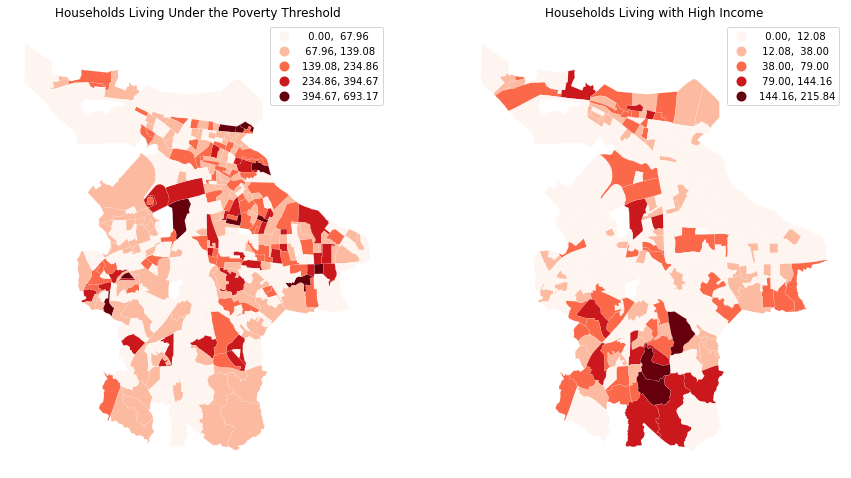

In [20]:
# create the 1x2 subplots
# set sharex and sharey to true to scale each map equally
fig, axs = plt.subplots(1, 2, figsize=(15, 12), sharex=True, sharey=True)

# name each subplot
ax1, ax2 = axs

# percent households with Less than $19,000 on the left
income_web_mercator.plot(column='Percent Households with Less than $19,999', 
            cmap='Reds', 
            scheme='NaturalBreaks',
            edgecolor='white', 
            linewidth=0.1, 
            ax=ax1, # this assigns the map to the subplot,
            legend=True
           )

ax1.axis("off")
ax1.set_title("Households Living Under the Poverty Threshold")

#  Percent Households with more than $125,000 map on the right
income_web_mercator.plot(column='Percent Households with More than $125,000', 
            cmap='Reds', 
            scheme='NaturalBreaks',
            edgecolor='white', 
            linewidth=0.1, 
            ax=ax2, # this assigns the map to the subplot
            legend=True
           )

ax2.axis("off")
ax2.set_title("Households Living with High Income")

Text(0.5, 1.0, 'Households Living with Medium Income')

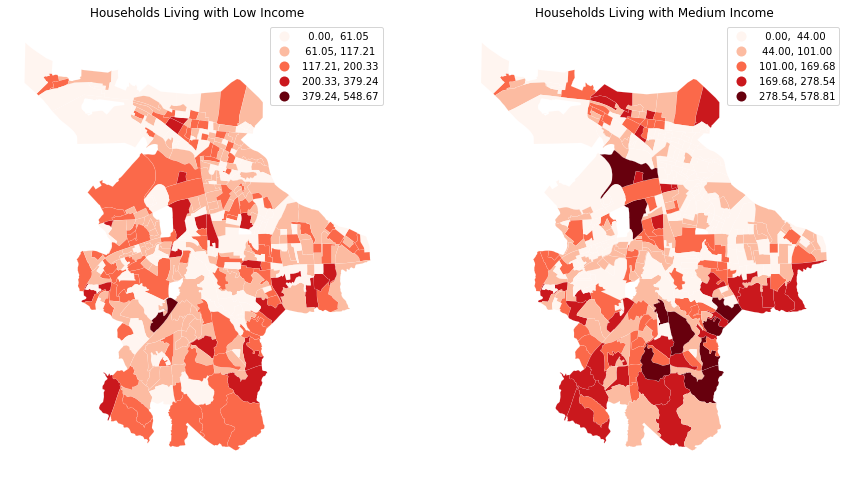

In [132]:
# create the 1x2 subplots
# set sharex and sharey to true to scale each map equally
fig, axs = plt.subplots(1, 2, figsize=(15, 12), sharex=True, sharey=True)

# name each subplot
ax1, ax2 = axs


income_web_mercator.plot(column='Percent Households with $20,000 to $49,999', 
            cmap='Reds', 
            scheme='NaturalBreaks',
            edgecolor='white', 
            linewidth=0.1, 
            ax=ax1, # this assigns the map to the subplot,
            legend=True
           )

ax1.axis("off")
ax1.set_title("Households Living with Low Income")


income_web_mercator.plot(column='Percent Households with $50,000 to $149,999', 
            cmap='Reds', 
            scheme='NaturalBreaks',
            edgecolor='white', 
            linewidth=0.1, 
            ax=ax2, # this assigns the map to the subplot
            legend=True
           )

ax2.axis("off")
ax2.set_title("Households Living with Medium Income")

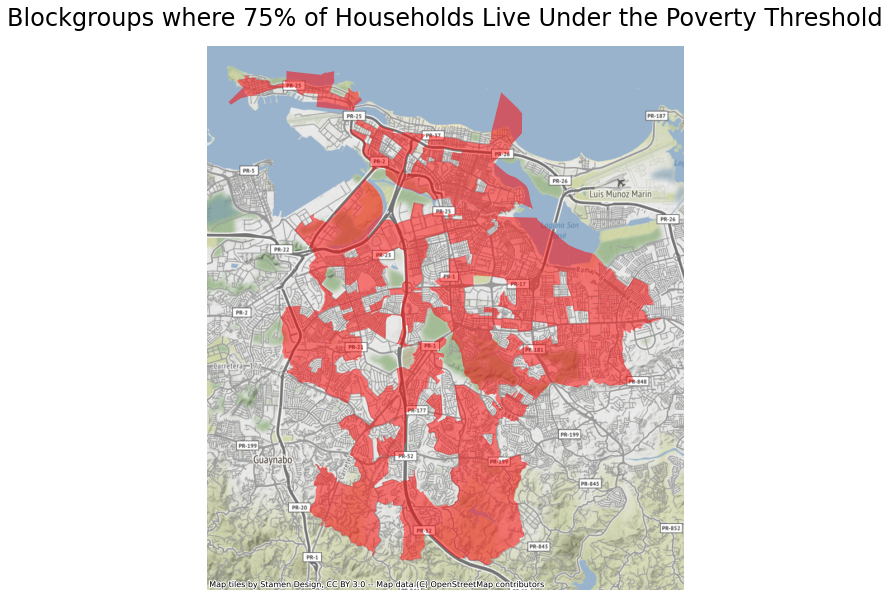

In [24]:
#Now I am going to add some basemaps

fig, ax = plt.subplots(figsize=(10, 10))

# add the layer with ax=ax in the argument 
income_web_mercator[income_web_mercator['Households with Less than $19,999'] > 75].plot(
                                                               ax=ax, 
                                                               color="red",
                                                               alpha=0.5
)

# turn the axis off
ax.axis('off')

# set a title
ax.set_title('Blockgroups where 75% of Households Live Under the Poverty Threshold',fontsize=24,pad=20)

# add a basemap
ctx.add_basemap(ax)

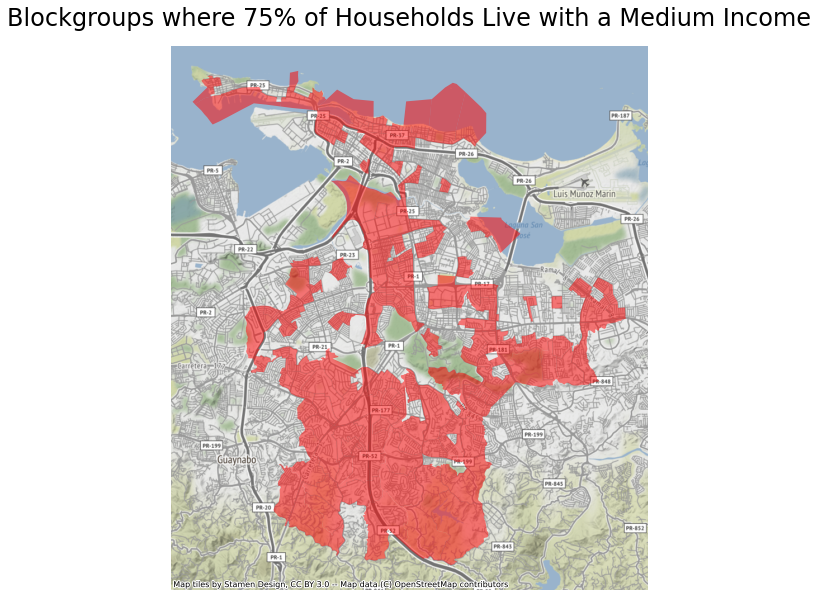

In [129]:
fig, ax = plt.subplots(figsize=(10, 10))

# add the layer with ax=ax in the argument 
income_web_mercator[income_web_mercator['Households with $50,000 to $149,999'] > 75].plot(
                                                               ax=ax, 
                                                               color="red",
                                                               alpha=0.5
)

# turn the axis off
ax.axis('off')

# set a title
ax.set_title('Blockgroups where 75% of Households Live with a Medium Income',fontsize=24,pad=20)

# add a basemap
ctx.add_basemap(ax)

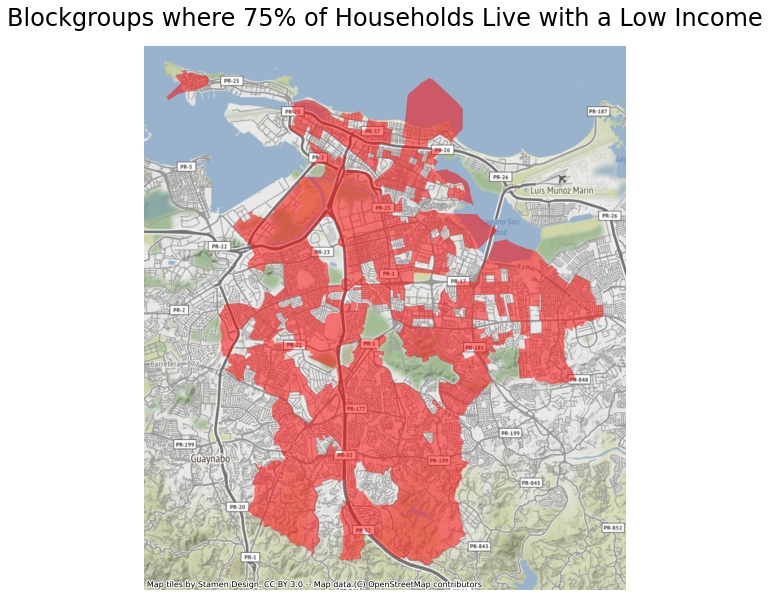

In [26]:
fig, ax = plt.subplots(figsize=(10, 10))

# add the layer with ax=ax in the argument 
income_web_mercator[income_web_mercator['Households with $20,000 to $49,999'] > 75].plot(
                                                               ax=ax, 
                                                               color="red",
                                                               alpha=0.5
)

# turn the axis off
ax.axis('off')

# set a title
ax.set_title('Blockgroups where 75% of Households Live with a Low Income',fontsize=24,pad=20)

# add a basemap
ctx.add_basemap(ax)

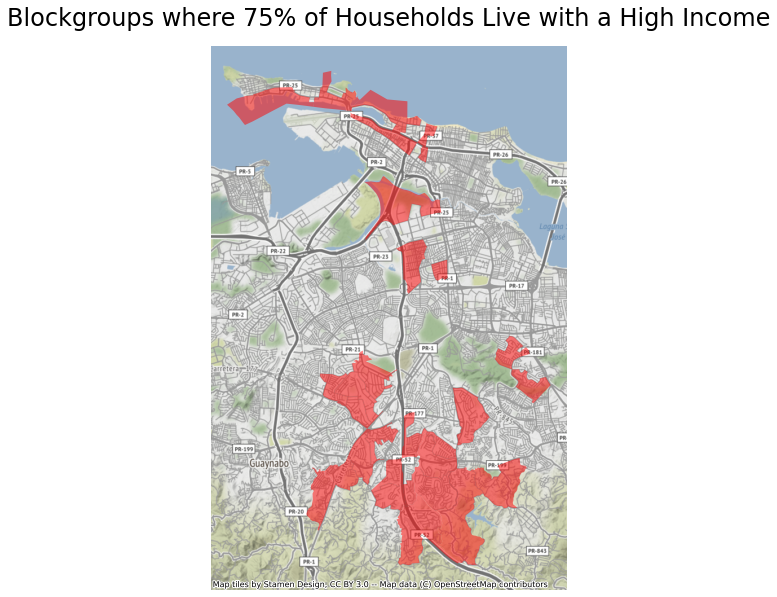

In [27]:
fig, ax = plt.subplots(figsize=(10, 10))

# add the layer with ax=ax in the argument 
income_web_mercator[income_web_mercator['Households with More than $125,000'] > 75].plot(
                                                               ax=ax, 
                                                               color="red",
                                                               alpha=0.5
)

# turn the axis off
ax.axis('off')

# set a title
ax.set_title('Blockgroups where 75% of Households Live with a High Income',fontsize=24,pad=20)

# add a basemap
ctx.add_basemap(ax)

#### Race Variable

In [28]:
#importing my data
race=gpd.read_file('acs2019_san juan_race.geojson')

In [29]:
race

,geoid,name,B03002001,"B03002001, Error",B03002002,"B03002002, Error",B03002003,"B03002003, Error",B03002004,"B03002004, Error",...,"B03002017, Error",B03002018,"B03002018, Error",B03002019,"B03002019, Error",B03002020,"B03002020, Error",B03002021,"B03002021, Error",geometry
0,15000US721270004001,"Block Group 1, San Juan, PR",902.0,256.0,0.0,14.0,0.0,14.0,0.0,14.0,...,14.0,140.0,78.0,106.0,98.0,0.0,14.0,106.0,98.0,"MULTIPOLYGON (((-66.11862 18.46914, -66.11834 ..."
1,15000US721270004002,"Block Group 2, San Juan, PR",647.0,178.0,66.0,63.0,22.0,24.0,37.0,58.0,...,14.0,6.0,10.0,55.0,75.0,0.0,14.0,55.0,75.0,"MULTIPOLYGON (((-66.11601 18.46817, -66.11569 ..."
2,15000US721270005061,"Block Group 1, San Juan, PR",589.0,156.0,104.0,72.0,104.0,72.0,0.0,14.0,...,14.0,34.0,37.0,40.0,39.0,10.0,14.0,30.0,39.0,"MULTIPOLYGON (((-66.11925 18.46353, -66.11908 ..."
3,15000US721270005062,"Block Group 2, San Juan, PR",926.0,243.0,61.0,81.0,61.0,81.0,0.0,14.0,...,14.0,31.0,34.0,147.0,147.0,11.0,16.0,136.0,147.0,"MULTIPOLYGON (((-66.12455 18.46155, -66.12021 ..."
4,15000US721270006001,"Block Group 1, San Juan, PR",630.0,173.0,0.0,14.0,0.0,14.0,0.0,14.0,...,14.0,59.0,86.0,84.0,74.0,0.0,14.0,84.0,74.0,"MULTIPOLYGON (((-66.10417 18.46589, -66.10386 ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,15000US721279801071,"Block Group 1, San Juan, PR",0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.11387 18.47213, -66.11294 ..."
361,15000US721279801081,"Block Group 1, San Juan, PR",0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.10669 18.45646, -66.10667 ..."
362,15000US721279802001,"Block Group 1, San Juan, PR",61.0,65.0,18.0,30.0,18.0,30.0,0.0,14.0,...,14.0,9.0,15.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.12927 18.47174, -66.12912 ..."
363,15000US721279803001,"Block Group 1, San Juan, PR",0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,...,14.0,0.0,14.0,0.0,14.0,0.0,14.0,0.0,14.0,"MULTIPOLYGON (((-66.08527 18.44116, -66.08280 ..."


In [30]:
# drop the row with index 0 (i.e. the first row)
race = race.drop([0])

In [31]:
#now I am going to get rid of error columns
columns_to_keep = ['geoid',
 'name',
 'B03002001',
 'B03002002',
 'B03002003',
 'B03002004',
 'B03002005',
 'B03002006',
 'B03002007',
 'B03002008',
 'B03002009',
 'B03002010',
 'B03002011',
 'B03002012',
 'B03002013',
 'B03002014',
 'B03002015',
 'B03002016',
 'B03002017',
 'B03002018',
 'B03002019',
 'B03002020',
 'B03002021',
 'geometry']

In [32]:
# redefine gdf with only columns to keep
race = race[columns_to_keep]

In [33]:
#now, I am renaming the columns using the data dictionary
race.columns = ['geoid',
'name',
'Total',
'Not Hispanic or Latino',
'White alone',
'Black or African American alone',
'American Indian and Alaska Native alone',
'Asian alone',
'Native Hawaiian and Other Pacific Islander alone',
'Some other race alone',
'Two or more races',
'Two races including Some other race',
'Two races excluding Some other race, and three or more races',
'Hispanic or Latino',
'White alone',
'Black or African American alone',
'American Indian and Alaska Native alone',
'Asian alone',
'Native Hawaiian and Other Pacific Islander alone',
'Some other race alone',
'Two or more races',
'Two races including Some other race',
'Two races excluding Some other race, and three or more races',
'geometry']

In [34]:
race_sorted = race.sort_values(by='Total',ascending = False)

In [35]:
race_sorted[['geoid','Total']].head(10)

,geoid,Total
364,16000US7276770,323279.0
199,15000US721270068001,4015.0
345,15000US721270100421,2983.0
340,15000US721270100222,2545.0
292,15000US721270091224,2434.0
349,15000US721270102001,2425.0
316,15000US721270098005,2419.0
346,15000US721270100422,2373.0
158,15000US721270054033,2330.0
239,15000US721270080023,2329.0


In [36]:
#same issue of 364 than on the other dataset. Let's get rid of it. 
race = race.drop([364])

In [37]:
#i am going to normalize the data now
list(race)

['geoid',
 'name',
 'Total',
 'Not Hispanic or Latino',
 'White alone',
 'Black or African American alone',
 'American Indian and Alaska Native alone',
 'Asian alone',
 'Native Hawaiian and Other Pacific Islander alone',
 'Some other race alone',
 'Two or more races',
 'Two races including Some other race',
 'Two races excluding Some other race, and three or more races',
 'Hispanic or Latino',
 'White alone',
 'Black or African American alone',
 'American Indian and Alaska Native alone',
 'Asian alone',
 'Native Hawaiian and Other Pacific Islander alone',
 'Some other race alone',
 'Two or more races',
 'Two races including Some other race',
 'Two races excluding Some other race, and three or more races',
 'geometry']

In [38]:
race['Percent Not Hispanic'] = race['Not Hispanic or Latino']/race['Total']*100
race['Percent Hispanic'] = race['Hispanic or Latino']/race['Total']*100

In [39]:
race.head()

,geoid,name,Total,Not Hispanic or Latino,White alone,Black or African American alone,American Indian and Alaska Native alone,Asian alone,Native Hawaiian and Other Pacific Islander alone,Some other race alone,...,American Indian and Alaska Native alone,Asian alone,Native Hawaiian and Other Pacific Islander alone,Some other race alone,Two or more races,Two races including Some other race,"Two races excluding Some other race, and three or more races",geometry,Percent Not Hispanic,Percent Hispanic
1,15000US721270004002,"Block Group 2, San Juan, PR",647.0,66.0,22.0,37.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,6.0,55.0,0.0,55.0,"MULTIPOLYGON (((-66.11601 18.46817, -66.11569 ...",10.200927,89.799073
2,15000US721270005061,"Block Group 1, San Juan, PR",589.0,104.0,104.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,34.0,40.0,10.0,30.0,"MULTIPOLYGON (((-66.11925 18.46353, -66.11908 ...",17.657046,82.342954
3,15000US721270005062,"Block Group 2, San Juan, PR",926.0,61.0,61.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,31.0,147.0,11.0,136.0,"MULTIPOLYGON (((-66.12455 18.46155, -66.12021 ...",6.587473,93.412527
4,15000US721270006001,"Block Group 1, San Juan, PR",630.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,59.0,84.0,0.0,84.0,"MULTIPOLYGON (((-66.10417 18.46589, -66.10386 ...",0.000000,100.000000
5,15000US721270006002,"Block Group 2, San Juan, PR",647.0,52.0,39.0,13.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,25.0,89.0,0.0,89.0,"MULTIPOLYGON (((-66.12381 18.46080, -66.12087 ...",8.037094,91.962906


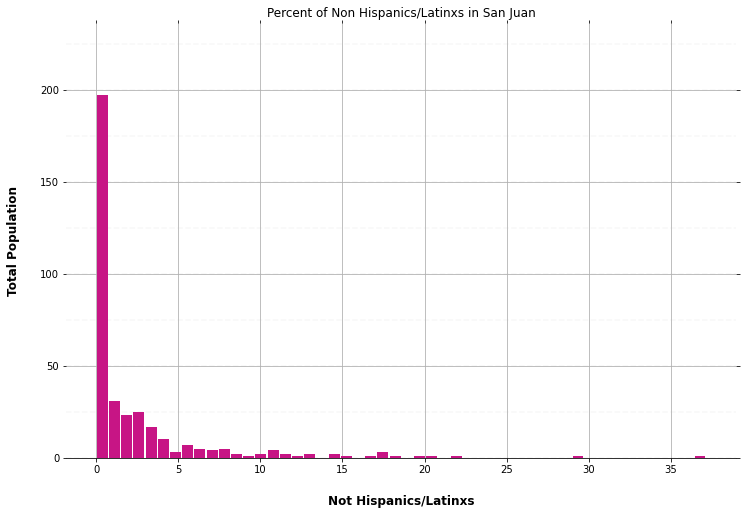

In [40]:
ax = race.hist(column='Percent Not Hispanic', bins=50, grid=True, figsize=(12,8), color='#c71585', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Percent of Non Hispanics/Latinxs in San Juan")

    # Set x-axis label
    x.set_xlabel("Not Hispanics/Latinxs", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("Total Population", labelpad=20, weight='bold', size=12)



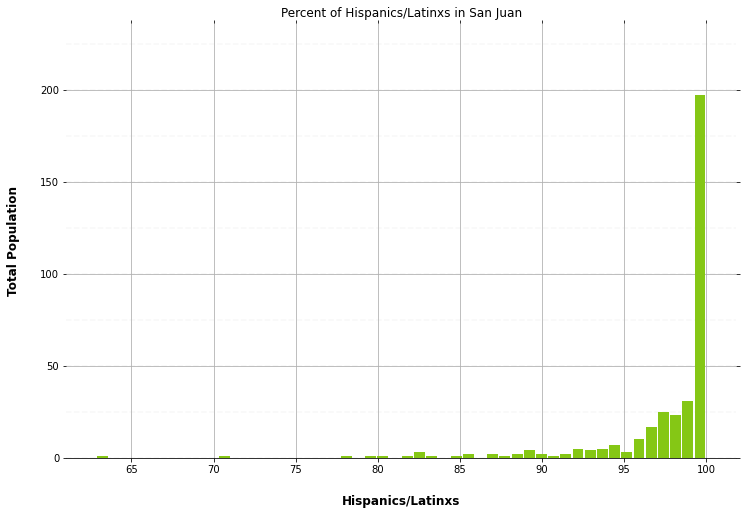

In [41]:
ax = race.hist(column='Percent Hispanic', bins=50, grid=True, figsize=(12,8), color='#85c715', zorder=2, rwidth=0.9)

ax = ax[0]
for x in ax:

    # Despine
    x.spines['right'].set_visible(False)
    x.spines['top'].set_visible(False)
    x.spines['left'].set_visible(False)

    # Switch off ticks
    x.tick_params(axis="both", which="both", bottom="off", top="off", labelbottom="on", left="off", right="off", labelleft="on")

    # Draw horizontal axis lines
    vals = x.get_yticks()
    for tick in vals:
        x.axhline(y=tick, linestyle='dashed', alpha=0.4, color='#eeeeee', zorder=1)

    # Remove title
    x.set_title("Percent of Hispanics/Latinxs in San Juan")

    # Set x-axis label
    x.set_xlabel("Hispanics/Latinxs", labelpad=20, weight='bold', size=12)

    # Set y-axis label
    x.set_ylabel("Total Population", labelpad=20, weight='bold', size=12)

    # Format y-axis label

AttributeError: 'numpy.ndarray' object has no attribute 'axis'

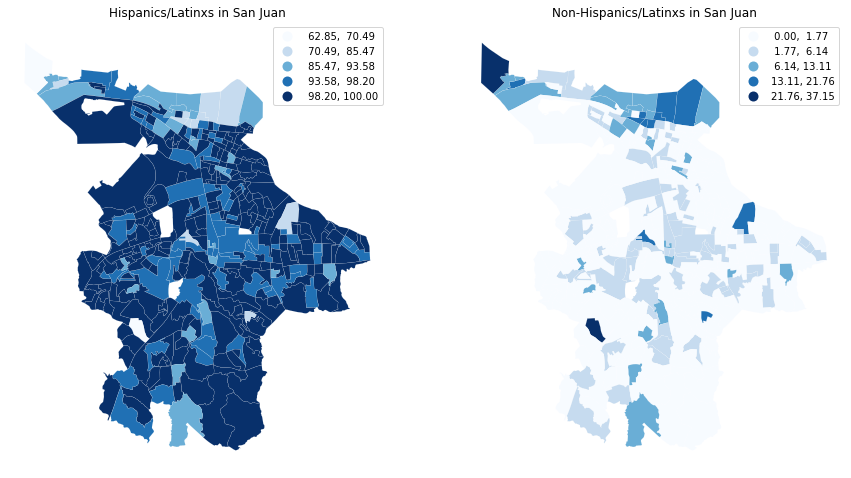

In [44]:
# create the 1x2 subplots
# set sharex and sharey to true to scale each map equally
fig, axs = plt.subplots(1, 2, figsize=(15, 12), sharex=True, sharey=True)

# name each subplot
ax1, ax2 = axs

# percent hispanics
race_web_mercator.plot(column='Percent Hispanic', 
            cmap='Blues', 
            scheme='NaturalBreaks',
            edgecolor='white', 
            linewidth=0.1, 
            ax=ax1, # this assigns the map to the subplot,
            legend=True
           )

ax1.axis("off")
ax1.set_title("Hispanics/Latinxs in San Juan")

#  Percent not hispanics
race_web_mercator.plot(column='Percent Not Hispanic', 
            cmap='Blues', 
            scheme='NaturalBreaks',
            edgecolor='white', 
            linewidth=0.1, 
            ax=ax2, # this assigns the map to the subplot
            legend=True
           )

ax2.axis("off")
ax2.set_title("Non-Hispanics/Latinxs in San Juan")
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [43]:
#now I will give it a basemap
race_web_mercator= race.to_crs(epsg=3857)

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:238: UserWarning:


/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:241: UserWarning:




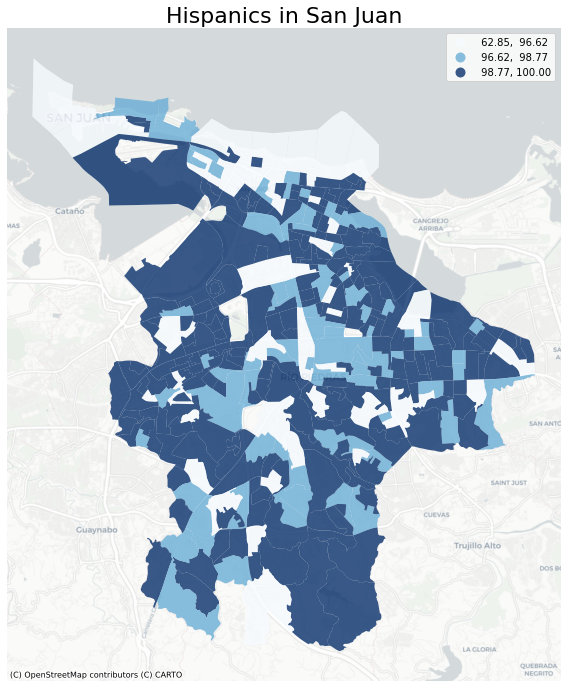

In [133]:
fig,ax = plt.subplots(figsize=(12,12))

race_web_mercator.plot(ax=ax,
        column='Percent Hispanic',
        legend=True,
        alpha=0.8,
        cmap='Blues',
        scheme='quantiles')

ax.axis('off')
ax.set_title('Hispanics in San Juan',fontsize=22)
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:238: UserWarning:


/opt/conda/lib/python3.9/site-packages/mapclassify/classifiers.py:241: UserWarning:




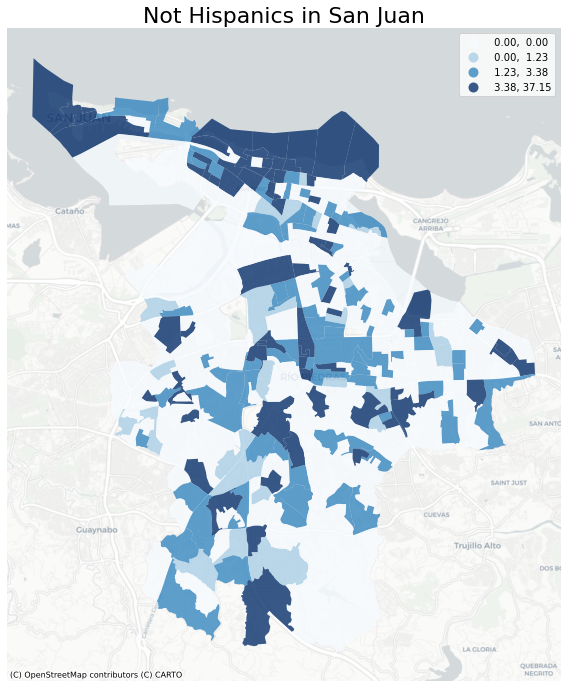

In [134]:
fig,ax = plt.subplots(figsize=(12,12))

race_web_mercator.plot(ax=ax,
        column='Percent Not Hispanic',
        legend=True,
        alpha=0.8,
        cmap='Blues',
        scheme='quantiles')

ax.axis('off')
ax.set_title('Not Hispanics in San Juan',fontsize=22)
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

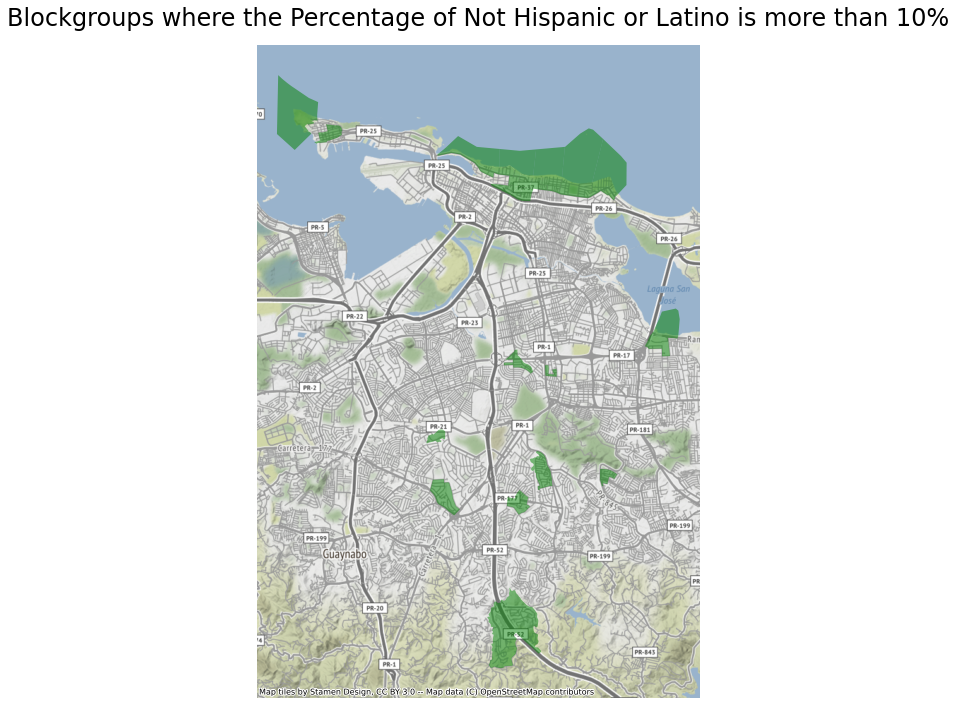

In [135]:
fig, ax = plt.subplots(figsize=(12, 12))

# add the layer with ax=ax in the argument 
race_web_mercator[race_web_mercator['Percent Not Hispanic'] > 10].plot(
                                                               ax=ax, 
                                                               color="green",
                                                               alpha=0.5
)

# turn the axis off
ax.axis('off')

# set a title
ax.set_title('Blockgroups where the Percentage of Not Hispanic or Latino is more than 10%',fontsize=24,pad=20)

# add a basemap
ctx.add_basemap(ax)

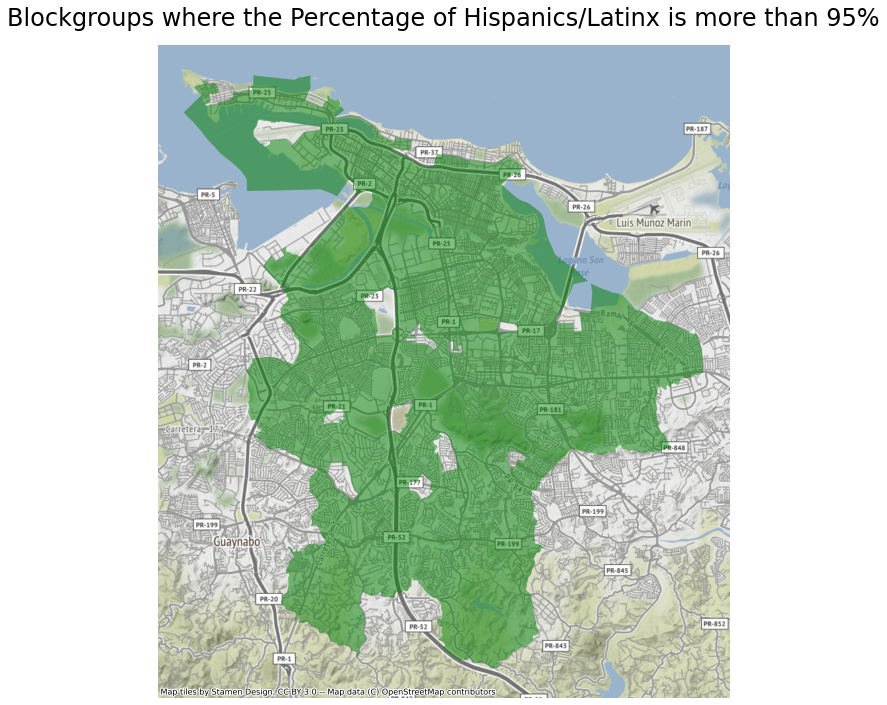

In [136]:
fig, ax = plt.subplots(figsize=(12, 12))

# add the layer with ax=ax in the argument 
race_web_mercator[race_web_mercator['Percent Hispanic'] > 90].plot(
                                                               ax=ax, 
                                                               color="green",
                                                               alpha=0.5
)

# turn the axis off
ax.axis('off')

# set a title
ax.set_title('Blockgroups where the Percentage of Hispanics/Latinx is more than 95%',fontsize=24,pad=20)

# add a basemap
ctx.add_basemap(ax)

Moving forward to tourism!

#### Tourism: Hotles and Tourist Inns

In [47]:
#uploading my data
myshpfile = gpd.read_file('g07_turismo_paradores_hoteles.shp')
myshpfile.to_file('myJson.geojson', driver='GeoJSON')

In [48]:
#to be able to map
tourism=gpd.GeoDataFrame(myshpfile, geometry=gpd.points_from_xy(myshpfile.easting, myshpfile.northing))

In [49]:
# subset the zero coordinate records
tourism[tourism.easting==0]

,height,id,northing,easting,nombre_,z_de_habit,direccion,pueblo,zip_code,telefono,telefono_1,fax,e_mail,endosado,zip_code_1,globalid,shape_leng,shape_area,geometry
165,0.0,0,0.0,0.0,Acacia Seaside Inn,None,"8 Taft Street, Ocean park",San Juan,911.0,0.0,787-725-0668,787-728-0671,reservations@acaciaseasideinn.com,Si,None,{4E108A7A-58D0-4779-A3FB-2AA440CE0B40},77.574326,322.788820,POINT (0.00000 0.00000)
167,0.0,0,0.0,0.0,ESJ Towers,None,None,Carolina,0.0,0.0,787-791-5151,787-641-3836,reservations@esjtowers.com,Si,00979,{C04F897B-6B4D-41C9-AC8C-8CA7DEAAF5C1},298.993814,2362.960658,POINT (0.00000 0.00000)
168,0.0,0,0.0,0.0,Embassy Suites Hotel & Casino,None,"8000 Tartak Street, Isla Verde",Carolina,0.0,0.0,787-791-0505,787-791-7776,max_rosado@hilton.com,Si,None,{83FFE20E-1012-4796-90E9-760E50AFC3B3},614.391991,12480.229048,POINT (0.00000 0.00000)
169,0.0,0,0.0,0.0,Borinquen Beach Inn,None,"5451 Isla Verde Avenue, Isla Verde",Carolina,0.0,0.0,787-728-8400,787-268-2411,Borinquenbeachinn@yahoo.com,Si,00979,{DA8033AF-CBEF-4640-B60C-AFD60230A26E},103.132416,499.997856,POINT (0.00000 0.00000)
170,0.0,0,0.0,0.0,Casa De Amistad,None,Calle Benite Castaño #27,Vieques,0.0,0.0,787-741-3758,N/A,viequesamistad@aol.com,Si,00765,{32A7C9CB-583F-438D-8274-29199780BF1B},64.243316,197.565217,POINT (0.00000 0.00000)
173,0.0,0,0.0,0.0,Las Casitas Village and Golden Door Spa,None,1000 El Conquistador,Fajardo,0.0,0.0,787-863-1000,787-863-6758,http://www.lascasitasvillage.com,Si,00738,{9B5835E1-9E3A-449E-BEAD-7AD306556D9F},156.163671,1151.065334,POINT (0.00000 0.00000)
174,0.0,0,0.0,0.0,Club Cala,None,"270 Harbour Drive suite No. 1, Palmas del Mar",Humacao,791.0,0.0,787-852-6000,787-852 6370,gmpr@villasatpalmas.com,Si,00791,{8CB3BF8E-C8A6-491E-B1F7-572E0B606DE8},388.413628,2204.778619,POINT (0.00000 0.00000)
175,0.0,0,0.0,0.0,Las Villas de Palma,None,"275 Palmas Inn Way, Suite 6",Humacao,0.0,0.0,939-645-0916,787-852-0927,jpico@villasatpalmas.com,Si,00791,{68646809-4094-4AB1-9084-0F056221956F},177.917015,1281.253270,POINT (0.00000 0.00000)
176,0.0,0,0.0,0.0,Club Seabourne,None,State Road 252 Sardinas 11 Beach,Culebra,0.0,0.0,787-742-3169,787-742-0210,mjose227@aol.com,Si,00775,{AA546375-0F05-49A7-8E0C-E2BF7263FEC2},104.296072,551.483322,POINT (0.00000 0.00000)
177,0.0,0,0.0,0.0,Parador JB Hidden Village,None,"Road 2, Int. 4416, km 1.3",Aguada,0.0,0.0,787-868-8686,787-868-8701,N/A,Si,None,{40D84971-CAD0-4D93-89F4-3EF6D5E194E7},114.049362,571.763614,POINT (0.00000 0.00000)


In [50]:
# drop the unmapped rows
tourism = tourism[tourism.easting!=0]

<AxesSubplot:>

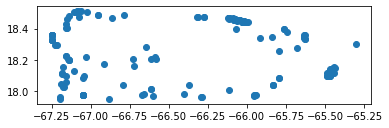

In [51]:
tourism.plot()

In [52]:
#let me create the web_mercator before forgetting

tourism.crs = "EPSG:4326"
tourism_web_mercator= tourism.to_crs(epsg=3857)

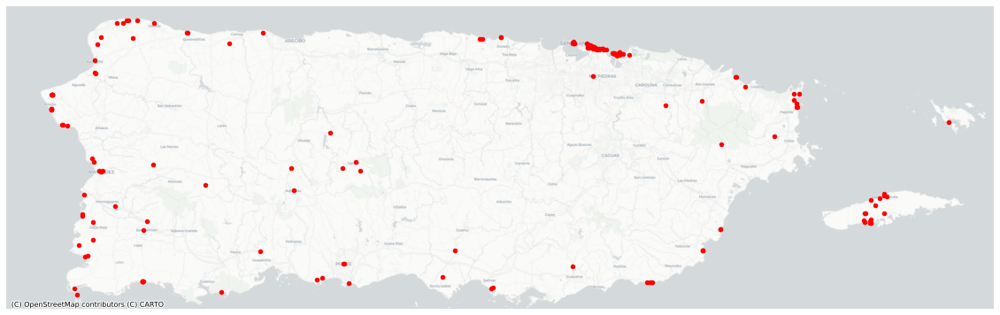

In [53]:
# map it!
fig,ax = plt.subplots(figsize=(20,20))

tourism_web_mercator.plot(ax=ax,
             color='red',
             markersize=20)

# no axis
ax.axis('off')
ax2.set_title("Hotels and Tourist Inns in Puerto Rico")
# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)


In [54]:
#okay, let's get rid of the rest of the hotels now. Data clean up
#trim the data to the bare minimum columns
tourism = tourism[['id','nombre_','pueblo','geometry']]

# rename the columns
tourism.columns = ['id','hotel','town', 'geometry']

In [55]:
tourism.head()

,id,hotel,town,geometry
0,218,Bravo Beach Hotel/Ocean Side Boutique Hotel,Vieques,POINT (-65.44160 18.15550)
1,227,Ocean View Hotel,Vieques,POINT (-65.44300 18.15080)
2,212,Wyndham Martineau Bay Resort & Spa,Vieques,POINT (-65.47130 18.14170)
3,213,Crow's Nest Inn,Vieques,POINT (-65.46210 18.13100)
4,228,Casa del Francés,Vieques,POINT (-65.47070 18.10210)


In [56]:
tourism['town'].value_counts()

San Juan        44
Carolina        17
Vieques         16
Rincon          13
Cabo Rojo       11
Isabela          6
Lajas            6
Mayaguez         6
Fajardo          6
Aguadilla        5
Ponce            5
Patillas         4
Dorado           4
Yabucoa          3
Jayuya           3
Rio Grande       3
San German       2
Quebradillas     2
Adjuntas         2
Humacao          2
Salinas          2
Las Marias       1
Santa Isabel     1
Anasco           1
Hormigueros      1
Ceiba            1
Camuy            1
Luquillo         1
Culebra          1
Guayanilla       1
Utuado           1
Cayey            1
Canovanas        1
Naguabo          1
Guanica          1
Coamo            1
Hatilllo         1
Maricao          1
Name: town, dtype: int64

There are 44 hotels in San Juan. Let's only have them.

In [57]:
tourism_sorted = tourism.sort_values(by='town')
# I want to see all the data
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [58]:
tourism_sorted

,id,hotel,town,geometry
91,1,Monte Río Hotel,Adjuntas,POINT (-66.72290 18.16170)
126,2,Parador Villas Sotomayor,Adjuntas,POINT (-66.72750 18.20740)
116,9,Hacienda El Pedregal,Aguadilla,POINT (-67.15430 18.40490)
115,10,Cielo Mar Hotel,Aguadilla,POINT (-67.15240 18.40250)
110,7,La Cima Hotel,Aguadilla,POINT (-67.10520 18.50590)
112,5,Parador El Faro,Aguadilla,POINT (-67.14850 18.46280)
111,4,Punta Borinquen Resort & Casino,Aguadilla,POINT (-67.14060 18.47760)
184,12,Rincón Beach Resort,Anasco,POINT (-67.21380 18.29610)
123,17,Joyuda Beach Hotel,Cabo Rojo,POINT (-67.17670 18.15250)
122,14,Lighthouse Inn,Cabo Rojo,POINT (-67.15820 18.09690)


In [59]:
#Okay, now I just remove the ones I am not going to need.
tourism = tourism.drop([91,126,116,115,110,112,111,184,123,122,121,120,
                        119,152,98,101,99,100,179,153,77,21,14,81,130,129,9,13,145,135,128,95,85,93,178,18,17,109,108,
                       107,106,105,190,197,146,90,147,113,138,96,97,114,118,148,198,125,124,117,94,161,185,79,16,15,84,134,127,
                       89,87,86,88,103,102,143,142,141,140,160,104,139,59,166,183,83,144,151,74,76,78,137,80,156,159,
                       189,92,6,3,4,2,1,5,7,154,171,8,157,150,149,131,172,0,19,20,136,57,67,68,58,56,65,61,69,70,66,
                       71,63,132,72,10,158,62])

In [60]:
tourism

,id,hotel,town,geometry
11,178,Gallery Inn,San Juan,POINT (-66.11650 18.46810)
12,199,Holiday Inn Express,San Juan,POINT (-66.07570 18.45710)
22,164,Alelí by the Sea Guest House,San Juan,POINT (-66.07290 18.45720)
23,158,El Convento Hotel,San Juan,POINT (-66.11850 18.46600)
24,194,Park Plaza Normandie,San Juan,POINT (-66.08730 18.46430)
25,173,Hotel Casa San Jose,San Juan,POINT (-66.11690 18.46430)
26,195,Caribe Hilton,San Juan,POINT (-66.08540 18.46340)
27,193,Wyndham Condado Plaza Hotel & Casino,San Juan,POINT (-66.08100 18.46090)
28,159,Hotel,San Juan,POINT (-66.08000 18.46050)
29,161,San Juan Beach Hotel,San Juan,POINT (-66.07810 18.45960)


In [61]:
tourism=tourism.drop([75,82,192,193])

In [62]:
tourism.shape

(44, 4)

In [63]:
#Good! Let's map it now.

In [64]:
#let me create the web_mercator before forgetting

tourism.crs = "EPSG:4326"
tourism_web_mercator= tourism.to_crs(epsg=3857)

In [65]:
tourism_web_mercator.shape

(44, 4)

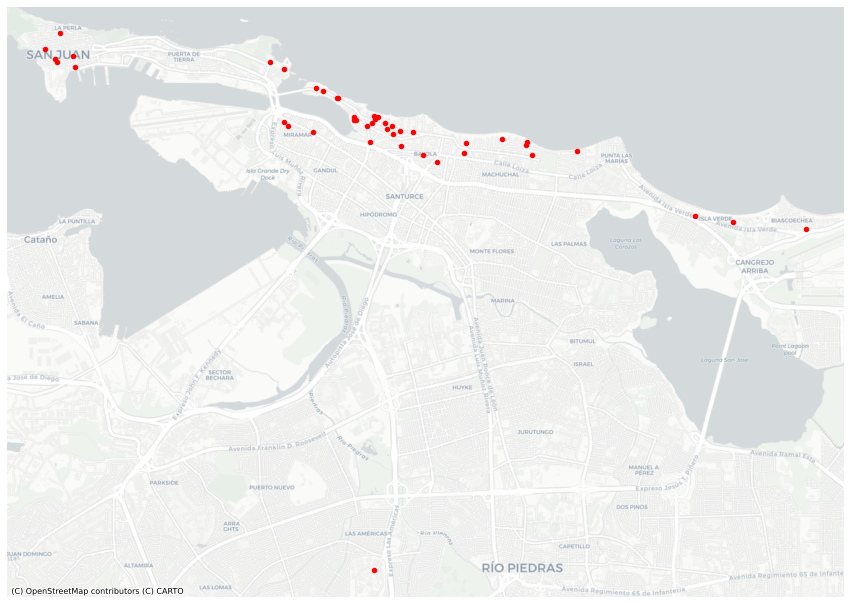

In [137]:
# map it!
fig,ax = plt.subplots(figsize=(15,15))

tourism_web_mercator.plot(ax=ax,
             color='red',
             markersize=20)

# no axis
ax.axis('off')
ax2.set_title("Hotels and Tourist Inns in Puerto Rico")
# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)


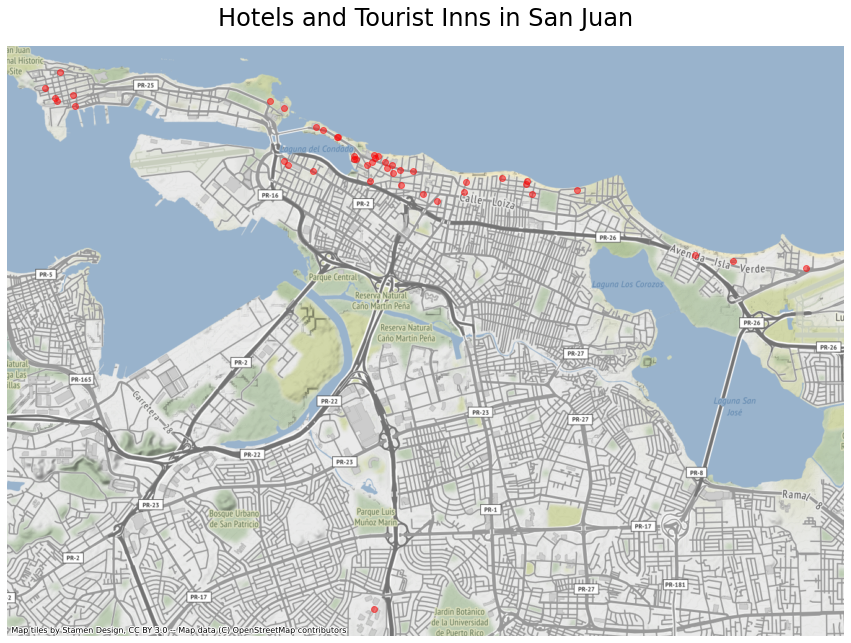

In [138]:
fig, ax = plt.subplots(figsize=(15, 15))

# add the layer with ax=ax in the argument 
tourism_web_mercator.plot(
                                                               ax=ax, 
                                                               color="red",
                                                               alpha=0.5
)

# turn the axis off
ax.axis('off')

# set a title
ax.set_title('Hotels and Tourist Inns in San Juan',fontsize=24,pad=20)

# add a basemap
ctx.add_basemap(ax)

#### Creating multi-layered maps

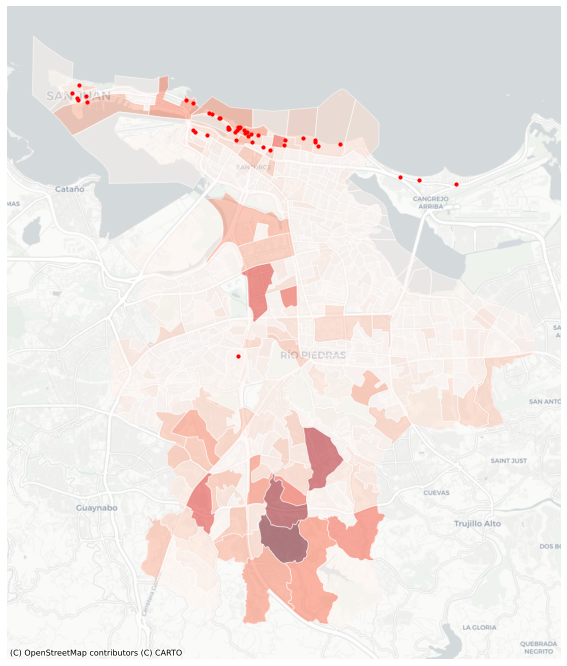

In [139]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(12, 12))

# blockgroups (income)
income_web_mercator.plot(ax=ax, # this puts it in the ax plot
        cmap='Reds',
        edgecolor='white',
        alpha=0.5, 
        column='Percent Households with More than $125,000')

# hotels
tourism_web_mercator.plot(ax=ax, # this also puts it in the same ax plot
            color='red',
            markersize=10
            )

# use the bounding box coordinates to set the x and y limits
#
#ax.set_xlim(minx - 100, maxx + 1000) # added/substracted value is to give some margin around total bounds
#ax.set_ylim(miny - 100, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

The map above shows where the hotels in San Juan are, and the percent of households that earn a high income (above 125,000). 

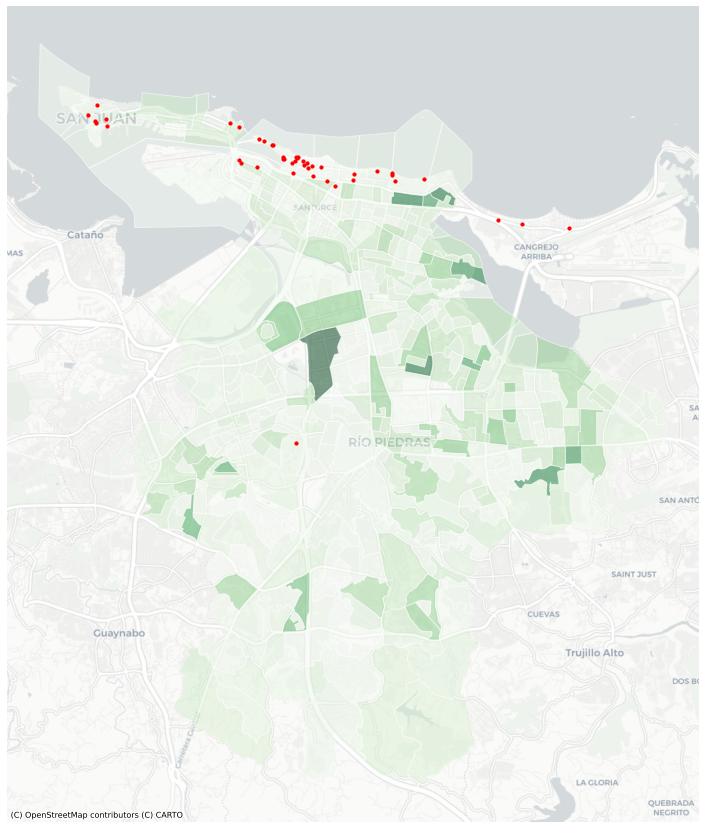

In [69]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(15, 15))

# blockgroups (income)
income_web_mercator.plot(ax=ax, # this puts it in the ax plot
        cmap='Greens',
        edgecolor='white',
        alpha=0.5, 
        column='Percent Households with Less than $19,999')

# hotels
tourism_web_mercator.plot(ax=ax, # this also puts it in the same ax plot
            color='red',
            markersize=10
            )

# use the bounding box coordinates to set the x and y limits
#
#ax.set_xlim(minx - 100, maxx + 1000) # added/substracted value is to give some margin around total bounds
#ax.set_ylim(miny - 100, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

The map above shows the hotels in San Juan, as well as the population that leaves under the poverty threshold.

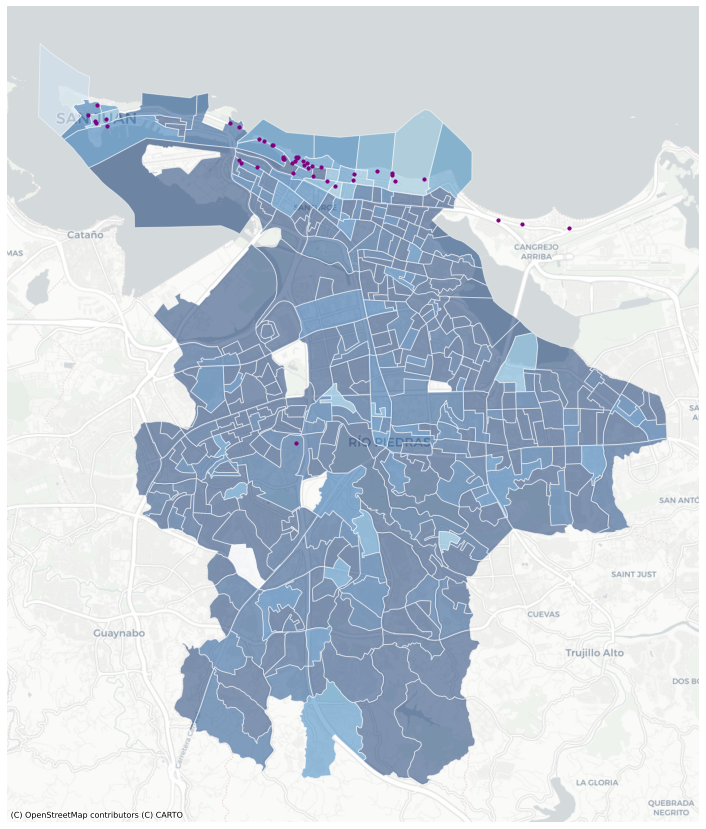

In [70]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(15, 15))

# blockgroups (income)
race_web_mercator.plot(ax=ax, # this puts it in the ax plot
        cmap='Blues',
        edgecolor='white',
        alpha=0.5, 
        column='Percent Hispanic')

# hotels
tourism_web_mercator.plot(ax=ax, # this also puts it in the same ax plot
            color='purple',
            markersize=10
            )

# use the bounding box coordinates to set the x and y limits
#
#ax.set_xlim(minx - 100, maxx + 1000) # added/substracted value is to give some margin around total bounds
#ax.set_ylim(miny - 100, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

This map above shows the Hispanic population with hotels. It clearly gets lighther in Santurce...

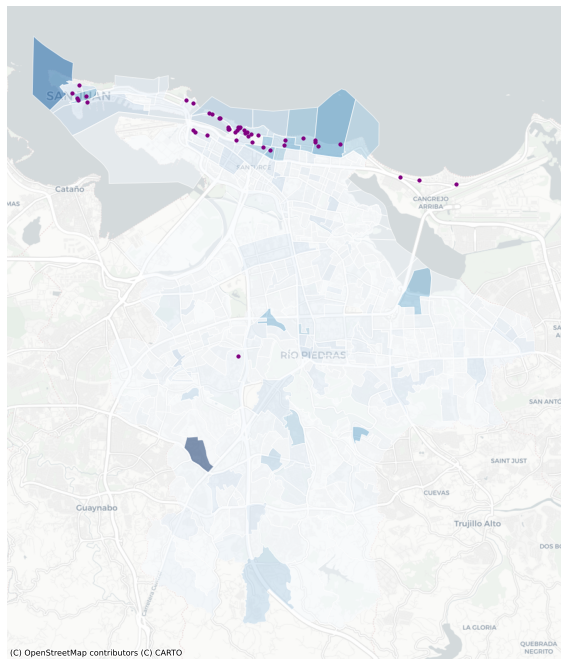

In [141]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(12, 12))

# blockgroups (income)
race_web_mercator.plot(ax=ax, # this puts it in the ax plot
        cmap='Blues',
        edgecolor='white',
        alpha=0.5, 
        column='Percent Not Hispanic')

# hotels
tourism_web_mercator.plot(ax=ax, # this also puts it in the same ax plot
            color='purple',
            markersize=10
            )

# use the bounding box coordinates to set the x and y limits
#
#ax.set_xlim(minx - 100, maxx + 1000) # added/substracted value is to give some margin around total bounds
#ax.set_ylim(miny - 100, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

Finally, the map above shows the hotels with the percentage of Non-Hispanic population.

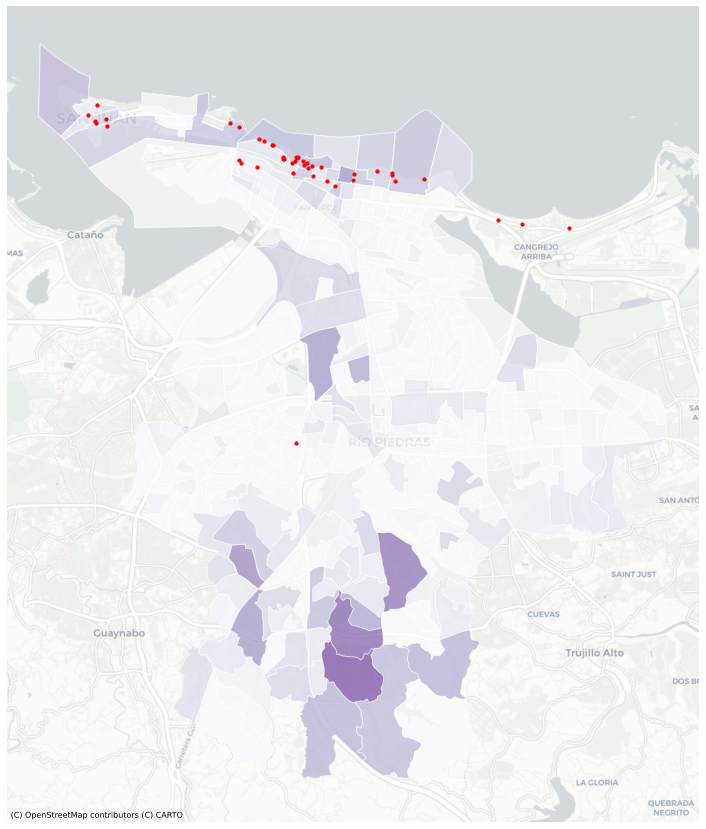

In [95]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(15, 15))

# blockgroups (income)
race_web_mercator.plot(ax=ax, # this puts it in the ax plot
        cmap='Purples',
        edgecolor='white',
        alpha=0.5, 
        column='Percent Not Hispanic')

# income
income_web_mercator.plot(ax=ax, # this also puts it in the same ax plot
             cmap='Purples',
        edgecolor='white',
        alpha=0.5, 
        column='Percent Households with More than $125,000')

#hotels
tourism_web_mercator.plot(ax=ax, # this also puts it in the same ax plot
            color='red',
            markersize=10
            )
            

# use the bounding box coordinates to set the x and y limits
#
#ax.set_xlim(minx - 100, maxx + 1000) # added/substracted value is to give some margin around total bounds
#ax.set_ylim(miny - 100, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

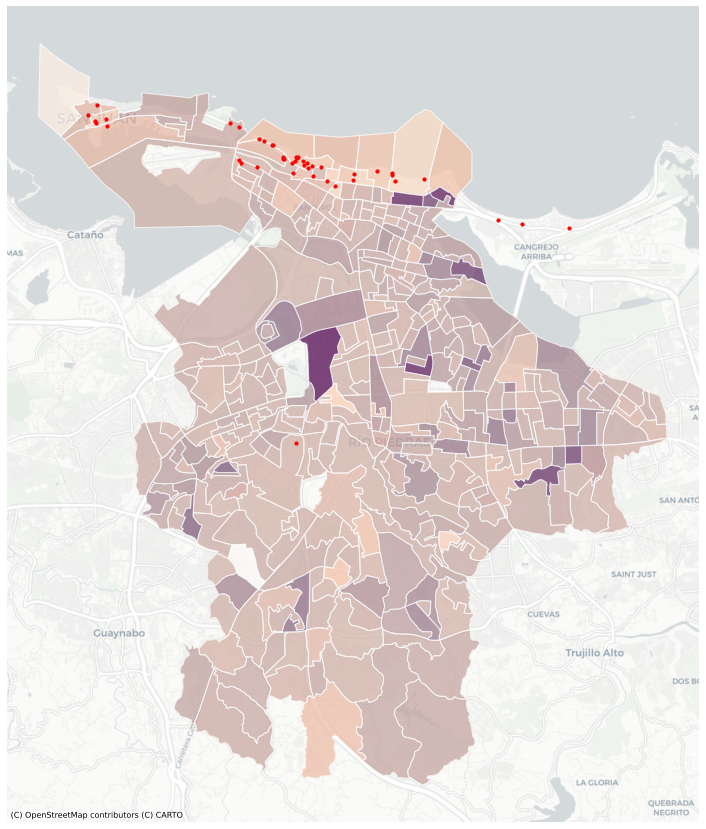

In [96]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(15, 15))

# blockgroups (income)
race_web_mercator.plot(ax=ax, # this puts it in the ax plot
        cmap='Oranges',
        edgecolor='white',
        alpha=0.5, 
        column='Percent Hispanic')

# income
income_web_mercator.plot(ax=ax, # this also puts it in the same ax plot
             cmap='Purples',
        edgecolor='white',
        alpha=0.5, 
        column='Percent Households with Less than $19,999')

#hotels
tourism_web_mercator.plot(ax=ax, # this also puts it in the same ax plot
            color='red',
            markersize=10
            )

# use the bounding box coordinates to set the x and y limits
#
#ax.set_xlim(minx - 100, maxx + 1000) # added/substracted value is to give some margin around total bounds
#ax.set_ylim(miny - 100, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

The two maps above I am not sure if they're the best... one shows the percent of Not Hispanic and population that lives with high income (and the hotels are mapped there as well). The second one shows the percent of Hispanics and people living under poverty (with hotels). I don't think this is too illuminating (rather, it's quite confusing).

#### Extras

Below, I will do some things that will produce errors. I am just leaving this as part of my draft (not the final version). Just putting this here so I can ask Yoh, or Ryan, or Chris.

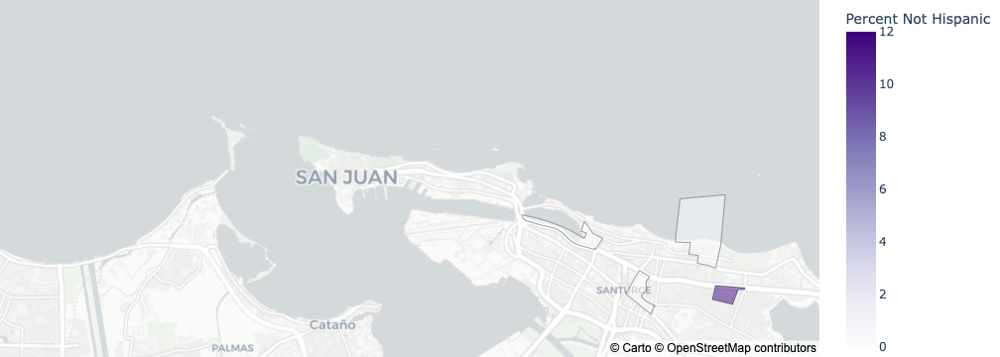

In [118]:
import plotly.express as px

fig = px.choropleth_mapbox(race, geojson=race, locations='Total', color='Percent Not Hispanic',
                           color_continuous_scale="Purples",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=12, center = {"lat": 18.465, "lon": -66.1057},
                           opacity=0.5,
                           labels={''}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Okay that worked better than I had thought... I think I could improve it. I also wonder if I can add the hotels here...

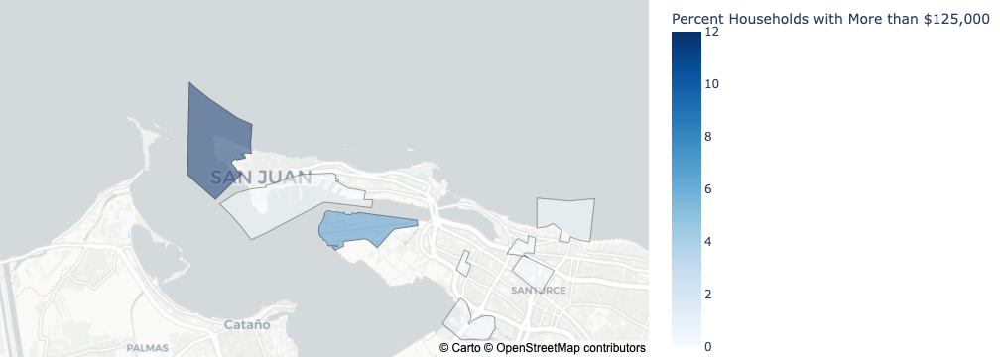

In [123]:
fig = px.choropleth_mapbox(income, geojson=income, locations='Total', color='Percent Households with More than $125,000',
                           color_continuous_scale="Blues",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=12, center = {"lat": 18.465, "lon": -66.1057},
                           opacity=0.5,
                           labels={''}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

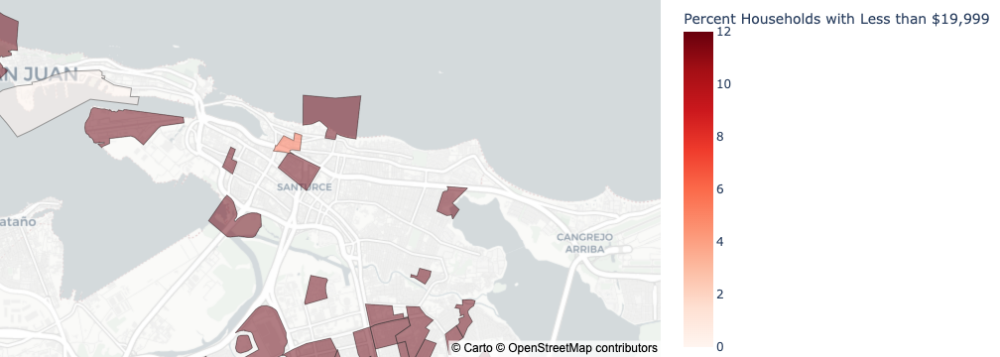

In [122]:
fig = px.choropleth_mapbox(income, geojson=income, locations='Total', color='Percent Households with Less than $19,999',
                           color_continuous_scale="Reds",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=12, center = {"lat": 18.4481, "lon": -66.0642},
                           opacity=0.5,
                           labels={''}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()